In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


# Defining Input parameters

In [2]:
# Root directory for dataset
dataroot = "danbooru2020/512px"

# Number of workers for dataloader
workers = 4

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 2

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# Data

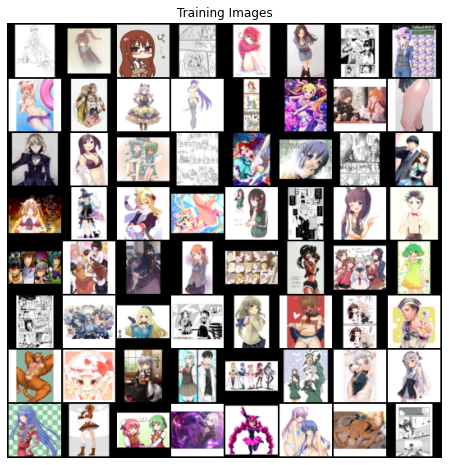

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

 # Weight Initialization

In [4]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Generator Model

In [5]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)
    
    
# Create the generator
netG = Generator(ngpu).to(device)
netG = torch.load('generator.pt')
# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
# netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


# Discriminator Model


In [6]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)
    
    
# Create the Discriminator
netD = Discriminator(ngpu).to(device)
netD = torch.load('discriminator.pt')

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
# netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


# Loss Functions and optimizers

In [7]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# Training our GAN  

In [8]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    torch.save(netG,'Generator.pt')
    torch.save(netD,'Discriminator.pt')

Starting Training Loop...
[0/2][0/8320]	Loss_D: 0.1548	Loss_G: 1.0026	D(x): 0.8890	D(G(z)): 0.0211 / 0.4737
[0/2][50/8320]	Loss_D: 0.1196	Loss_G: 4.4377	D(x): 0.9053	D(G(z)): 0.0097 / 0.0273
[0/2][100/8320]	Loss_D: 0.1284	Loss_G: 4.3350	D(x): 0.9011	D(G(z)): 0.0139 / 0.0243
[0/2][150/8320]	Loss_D: 0.0444	Loss_G: 4.3138	D(x): 0.9923	D(G(z)): 0.0353 / 0.0208
[0/2][200/8320]	Loss_D: 0.0305	Loss_G: 4.3982	D(x): 0.9962	D(G(z)): 0.0258 / 0.0224
[0/2][250/8320]	Loss_D: 0.1621	Loss_G: 3.4263	D(x): 0.9585	D(G(z)): 0.1023 / 0.0537
[0/2][300/8320]	Loss_D: 0.1571	Loss_G: 3.8697	D(x): 0.8986	D(G(z)): 0.0384 / 0.0397
[0/2][350/8320]	Loss_D: 0.1271	Loss_G: 4.9392	D(x): 0.8997	D(G(z)): 0.0119 / 0.0145
[0/2][400/8320]	Loss_D: 0.1165	Loss_G: 4.1281	D(x): 0.9204	D(G(z)): 0.0254 / 0.0269
[0/2][450/8320]	Loss_D: 0.0470	Loss_G: 4.6363	D(x): 0.9712	D(G(z)): 0.0167 / 0.0155


/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:793: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


[0/2][500/8320]	Loss_D: 0.9496	Loss_G: 2.5928	D(x): 0.6040	D(G(z)): 0.1624 / 0.1894
[0/2][550/8320]	Loss_D: 0.1774	Loss_G: 3.9425	D(x): 0.9741	D(G(z)): 0.1266 / 0.0328
[0/2][600/8320]	Loss_D: 0.4133	Loss_G: 1.7261	D(x): 0.7431	D(G(z)): 0.0305 / 0.2738
[0/2][650/8320]	Loss_D: 0.2397	Loss_G: 5.2429	D(x): 0.9842	D(G(z)): 0.1803 / 0.0082
[0/2][700/8320]	Loss_D: 0.5258	Loss_G: 1.0856	D(x): 0.6822	D(G(z)): 0.0659 / 0.4310
[0/2][750/8320]	Loss_D: 0.1418	Loss_G: 3.5301	D(x): 0.9142	D(G(z)): 0.0405 / 0.0496
[0/2][800/8320]	Loss_D: 0.0997	Loss_G: 4.3390	D(x): 0.9307	D(G(z)): 0.0234 / 0.0244
[0/2][850/8320]	Loss_D: 0.1114	Loss_G: 5.0983	D(x): 0.9727	D(G(z)): 0.0758 / 0.0097
[0/2][900/8320]	Loss_D: 0.7584	Loss_G: 1.5318	D(x): 0.5871	D(G(z)): 0.0428 / 0.3195
[0/2][950/8320]	Loss_D: 0.3582	Loss_G: 5.7596	D(x): 0.9951	D(G(z)): 0.2675 / 0.0057
[0/2][1000/8320]	Loss_D: 0.1478	Loss_G: 3.8223	D(x): 0.9612	D(G(z)): 0.0905 / 0.0358
[0/2][1050/8320]	Loss_D: 0.1476	Loss_G: 4.0389	D(x): 0.9807	D(G(z)): 0.1123

/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:599: UserWarning: Metadata Warning, tag 296 had too many entries: 2, expected 1
  warnings.warn(


[0/2][1250/8320]	Loss_D: 0.0746	Loss_G: 7.2561	D(x): 0.9343	D(G(z)): 0.0028 / 0.0016
[0/2][1300/8320]	Loss_D: 0.0243	Loss_G: 5.2759	D(x): 0.9836	D(G(z)): 0.0074 / 0.0081
[0/2][1350/8320]	Loss_D: 0.1906	Loss_G: 2.9301	D(x): 0.8803	D(G(z)): 0.0452 / 0.0988
[0/2][1400/8320]	Loss_D: 0.4048	Loss_G: 7.4145	D(x): 0.9982	D(G(z)): 0.2966 / 0.0010
[0/2][1450/8320]	Loss_D: 0.0334	Loss_G: 5.0716	D(x): 0.9814	D(G(z)): 0.0140 / 0.0131
[0/2][1500/8320]	Loss_D: 0.1710	Loss_G: 3.9520	D(x): 0.9411	D(G(z)): 0.0914 / 0.0312
[0/2][1550/8320]	Loss_D: 0.1035	Loss_G: 4.0878	D(x): 0.9230	D(G(z)): 0.0154 / 0.0325


/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:599: UserWarning: Metadata Warning, tag 296 had too many entries: 2, expected 1
  warnings.warn(


[0/2][1600/8320]	Loss_D: 1.5510	Loss_G: 1.6660	D(x): 0.3982	D(G(z)): 0.0435 / 0.3481
[0/2][1650/8320]	Loss_D: 0.1633	Loss_G: 3.0580	D(x): 0.9291	D(G(z)): 0.0732 / 0.0833
[0/2][1700/8320]	Loss_D: 0.0715	Loss_G: 5.0386	D(x): 0.9818	D(G(z)): 0.0467 / 0.0134
[0/2][1750/8320]	Loss_D: 0.0839	Loss_G: 3.8077	D(x): 0.9684	D(G(z)): 0.0469 / 0.0416
[0/2][1800/8320]	Loss_D: 0.3759	Loss_G: 5.3458	D(x): 0.9948	D(G(z)): 0.2671 / 0.0088


/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:793: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


[0/2][1850/8320]	Loss_D: 0.5248	Loss_G: 2.2466	D(x): 0.6447	D(G(z)): 0.0055 / 0.1857
[0/2][1900/8320]	Loss_D: 0.0382	Loss_G: 4.6067	D(x): 0.9958	D(G(z)): 0.0327 / 0.0182
[0/2][1950/8320]	Loss_D: 0.2041	Loss_G: 3.2222	D(x): 0.8451	D(G(z)): 0.0091 / 0.0715
[0/2][2000/8320]	Loss_D: 0.1879	Loss_G: 3.0662	D(x): 0.9034	D(G(z)): 0.0705 / 0.0806
[0/2][2050/8320]	Loss_D: 0.3184	Loss_G: 3.5136	D(x): 0.8139	D(G(z)): 0.0640 / 0.0604
[0/2][2100/8320]	Loss_D: 0.0907	Loss_G: 4.4584	D(x): 0.9842	D(G(z)): 0.0682 / 0.0187
[0/2][2150/8320]	Loss_D: 0.1539	Loss_G: 3.7019	D(x): 0.9364	D(G(z)): 0.0728 / 0.0422
[0/2][2200/8320]	Loss_D: 0.9968	Loss_G: 3.0998	D(x): 0.4639	D(G(z)): 0.0012 / 0.0977
[0/2][2250/8320]	Loss_D: 0.0878	Loss_G: 3.7660	D(x): 0.9379	D(G(z)): 0.0206 / 0.0391


/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:793: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


[0/2][2300/8320]	Loss_D: 0.1431	Loss_G: 4.9288	D(x): 0.9691	D(G(z)): 0.0915 / 0.0140
[0/2][2350/8320]	Loss_D: 0.0939	Loss_G: 4.3185	D(x): 0.9302	D(G(z)): 0.0157 / 0.0242
[0/2][2400/8320]	Loss_D: 0.0706	Loss_G: 4.1680	D(x): 0.9723	D(G(z)): 0.0396 / 0.0256
[0/2][2450/8320]	Loss_D: 0.0479	Loss_G: 4.6527	D(x): 0.9896	D(G(z)): 0.0347 / 0.0160
[0/2][2500/8320]	Loss_D: 0.2980	Loss_G: 4.6478	D(x): 0.9036	D(G(z)): 0.1535 / 0.0153
[0/2][2550/8320]	Loss_D: 0.1497	Loss_G: 2.5762	D(x): 0.8876	D(G(z)): 0.0187 / 0.1282
[0/2][2600/8320]	Loss_D: 0.0531	Loss_G: 4.9477	D(x): 0.9581	D(G(z)): 0.0090 / 0.0145
[0/2][2650/8320]	Loss_D: 1.2490	Loss_G: 1.5495	D(x): 0.4523	D(G(z)): 0.0739 / 0.3539
[0/2][2700/8320]	Loss_D: 0.1717	Loss_G: 4.9104	D(x): 0.9814	D(G(z)): 0.1226 / 0.0167
[0/2][2750/8320]	Loss_D: 1.0007	Loss_G: 0.9719	D(x): 0.5515	D(G(z)): 0.0815 / 0.5015
[0/2][2800/8320]	Loss_D: 0.3096	Loss_G: 1.9253	D(x): 0.7757	D(G(z)): 0.0257 / 0.2235
[0/2][2850/8320]	Loss_D: 0.1971	Loss_G: 4.2347	D(x): 0.9786	D(G(z

/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:599: UserWarning: Metadata Warning, tag 296 had too many entries: 2, expected 1
  warnings.warn(


[0/2][4150/8320]	Loss_D: 0.0615	Loss_G: 5.2080	D(x): 0.9597	D(G(z)): 0.0165 / 0.0121
[0/2][4200/8320]	Loss_D: 1.3643	Loss_G: 2.0296	D(x): 0.8712	D(G(z)): 0.4922 / 0.2853
[0/2][4250/8320]	Loss_D: 0.8733	Loss_G: 6.8141	D(x): 0.9924	D(G(z)): 0.4578 / 0.0046
[0/2][4300/8320]	Loss_D: 0.1056	Loss_G: 3.9833	D(x): 0.9521	D(G(z)): 0.0459 / 0.0389
[0/2][4350/8320]	Loss_D: 0.2411	Loss_G: 5.1391	D(x): 0.9963	D(G(z)): 0.1918 / 0.0107
[0/2][4400/8320]	Loss_D: 0.1346	Loss_G: 3.1337	D(x): 0.9186	D(G(z)): 0.0376 / 0.0703
[0/2][4450/8320]	Loss_D: 0.0709	Loss_G: 3.7547	D(x): 0.9624	D(G(z)): 0.0300 / 0.0395
[0/2][4500/8320]	Loss_D: 0.0842	Loss_G: 4.7801	D(x): 0.9925	D(G(z)): 0.0706 / 0.0147
[0/2][4550/8320]	Loss_D: 0.1160	Loss_G: 4.4952	D(x): 0.9058	D(G(z)): 0.0086 / 0.0240
[0/2][4600/8320]	Loss_D: 0.1708	Loss_G: 4.7597	D(x): 0.9518	D(G(z)): 0.1028 / 0.0164
[0/2][4650/8320]	Loss_D: 0.1170	Loss_G: 3.9505	D(x): 0.9095	D(G(z)): 0.0151 / 0.0363
[0/2][4700/8320]	Loss_D: 0.0803	Loss_G: 5.1023	D(x): 0.9319	D(G(z

/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:793: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


[1/2][50/8320]	Loss_D: 0.2712	Loss_G: 3.3619	D(x): 0.8814	D(G(z)): 0.0962 / 0.0706
[1/2][100/8320]	Loss_D: 0.0706	Loss_G: 4.9171	D(x): 0.9565	D(G(z)): 0.0232 / 0.0155
[1/2][150/8320]	Loss_D: 0.1222	Loss_G: 4.2243	D(x): 0.9087	D(G(z)): 0.0173 / 0.0293
[1/2][200/8320]	Loss_D: 0.1027	Loss_G: 4.0740	D(x): 0.9645	D(G(z)): 0.0596 / 0.0303
[1/2][250/8320]	Loss_D: 0.1179	Loss_G: 4.6673	D(x): 0.9268	D(G(z)): 0.0319 / 0.0174
[1/2][300/8320]	Loss_D: 0.1236	Loss_G: 3.9807	D(x): 0.9146	D(G(z)): 0.0242 / 0.0367


/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:599: UserWarning: Metadata Warning, tag 296 had too many entries: 2, expected 1
  warnings.warn(


[1/2][350/8320]	Loss_D: 0.0596	Loss_G: 4.8428	D(x): 0.9657	D(G(z)): 0.0187 / 0.0150
[1/2][400/8320]	Loss_D: 0.0450	Loss_G: 4.3123	D(x): 0.9740	D(G(z)): 0.0176 / 0.0288
[1/2][450/8320]	Loss_D: 0.2281	Loss_G: 6.4850	D(x): 0.9941	D(G(z)): 0.1790 / 0.0029
[1/2][500/8320]	Loss_D: 0.0769	Loss_G: 4.0675	D(x): 0.9687	D(G(z)): 0.0420 / 0.0303
[1/2][550/8320]	Loss_D: 0.1103	Loss_G: 4.0380	D(x): 0.9196	D(G(z)): 0.0183 / 0.0272
[1/2][600/8320]	Loss_D: 0.1991	Loss_G: 4.3053	D(x): 0.8701	D(G(z)): 0.0282 / 0.0274
[1/2][650/8320]	Loss_D: 0.1385	Loss_G: 4.7659	D(x): 0.9541	D(G(z)): 0.0761 / 0.0145
[1/2][700/8320]	Loss_D: 0.0839	Loss_G: 4.5307	D(x): 0.9616	D(G(z)): 0.0401 / 0.0205


/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:599: UserWarning: Metadata Warning, tag 296 had too many entries: 2, expected 1
  warnings.warn(


[1/2][750/8320]	Loss_D: 0.0402	Loss_G: 5.2322	D(x): 0.9911	D(G(z)): 0.0299 / 0.0097
[1/2][800/8320]	Loss_D: 0.0565	Loss_G: 4.6528	D(x): 0.9732	D(G(z)): 0.0265 / 0.0166
[1/2][850/8320]	Loss_D: 0.0601	Loss_G: 4.9209	D(x): 0.9513	D(G(z)): 0.0087 / 0.0160


/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:793: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


[1/2][900/8320]	Loss_D: 0.2894	Loss_G: 6.5935	D(x): 0.9917	D(G(z)): 0.2131 / 0.0024
[1/2][950/8320]	Loss_D: 0.2980	Loss_G: 4.7023	D(x): 0.9229	D(G(z)): 0.1634 / 0.0177
[1/2][1000/8320]	Loss_D: 0.1650	Loss_G: 3.5895	D(x): 0.9454	D(G(z)): 0.0834 / 0.0458
[1/2][1050/8320]	Loss_D: 0.5261	Loss_G: 1.8778	D(x): 0.6908	D(G(z)): 0.0233 / 0.2887
[1/2][1100/8320]	Loss_D: 0.1410	Loss_G: 5.5203	D(x): 0.9911	D(G(z)): 0.1152 / 0.0069
[1/2][1150/8320]	Loss_D: 0.1425	Loss_G: 3.9634	D(x): 0.9629	D(G(z)): 0.0827 / 0.0399
[1/2][1200/8320]	Loss_D: 0.1046	Loss_G: 4.2483	D(x): 0.9925	D(G(z)): 0.0805 / 0.0261
[1/2][1250/8320]	Loss_D: 0.0769	Loss_G: 4.7389	D(x): 0.9900	D(G(z)): 0.0594 / 0.0153
[1/2][1300/8320]	Loss_D: 0.0834	Loss_G: 4.4003	D(x): 0.9567	D(G(z)): 0.0338 / 0.0225
[1/2][1350/8320]	Loss_D: 0.1658	Loss_G: 2.9291	D(x): 0.8970	D(G(z)): 0.0426 / 0.0904
[1/2][1400/8320]	Loss_D: 0.0867	Loss_G: 5.0413	D(x): 0.9844	D(G(z)): 0.0654 / 0.0108
[1/2][1450/8320]	Loss_D: 0.1536	Loss_G: 4.9478	D(x): 0.9992	D(G(z))

/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:599: UserWarning: Metadata Warning, tag 296 had too many entries: 2, expected 1
  warnings.warn(


[1/2][1900/8320]	Loss_D: 0.0787	Loss_G: 5.1025	D(x): 0.9896	D(G(z)): 0.0630 / 0.0128
[1/2][1950/8320]	Loss_D: 0.0768	Loss_G: 4.8758	D(x): 0.9717	D(G(z)): 0.0427 / 0.0142
[1/2][2000/8320]	Loss_D: 0.0887	Loss_G: 4.3514	D(x): 0.9622	D(G(z)): 0.0458 / 0.0229
[1/2][2050/8320]	Loss_D: 0.1337	Loss_G: 4.4255	D(x): 0.9201	D(G(z)): 0.0162 / 0.0249
[1/2][2100/8320]	Loss_D: 0.0796	Loss_G: 4.5810	D(x): 0.9339	D(G(z)): 0.0082 / 0.0185
[1/2][2150/8320]	Loss_D: 0.0724	Loss_G: 4.4216	D(x): 0.9885	D(G(z)): 0.0566 / 0.0198
[1/2][2200/8320]	Loss_D: 0.0157	Loss_G: 6.4009	D(x): 0.9895	D(G(z)): 0.0050 / 0.0035
[1/2][2250/8320]	Loss_D: 0.0252	Loss_G: 4.4215	D(x): 0.9949	D(G(z)): 0.0196 / 0.0213
[1/2][2300/8320]	Loss_D: 0.0256	Loss_G: 5.8795	D(x): 0.9876	D(G(z)): 0.0121 / 0.0064
[1/2][2350/8320]	Loss_D: 0.3841	Loss_G: 2.2437	D(x): 0.7540	D(G(z)): 0.0315 / 0.1983
[1/2][2400/8320]	Loss_D: 0.0710	Loss_G: 4.5092	D(x): 0.9689	D(G(z)): 0.0335 / 0.0223
[1/2][2450/8320]	Loss_D: 0.1783	Loss_G: 4.5835	D(x): 0.9339	D(G(z

[1/2][6750/8320]	Loss_D: 0.1040	Loss_G: 3.7537	D(x): 0.9261	D(G(z)): 0.0184 / 0.0447
[1/2][6800/8320]	Loss_D: 0.0153	Loss_G: 5.6677	D(x): 0.9938	D(G(z)): 0.0090 / 0.0064
[1/2][6850/8320]	Loss_D: 0.2990	Loss_G: 3.7340	D(x): 0.9197	D(G(z)): 0.1632 / 0.0405
[1/2][6900/8320]	Loss_D: 0.1628	Loss_G: 5.4872	D(x): 0.8770	D(G(z)): 0.0093 / 0.0098
[1/2][6950/8320]	Loss_D: 0.2125	Loss_G: 5.5116	D(x): 0.9796	D(G(z)): 0.1507 / 0.0082
[1/2][7000/8320]	Loss_D: 0.0271	Loss_G: 5.3839	D(x): 0.9917	D(G(z)): 0.0179 / 0.0117
[1/2][7050/8320]	Loss_D: 0.0773	Loss_G: 4.3752	D(x): 0.9893	D(G(z)): 0.0603 / 0.0210
[1/2][7100/8320]	Loss_D: 0.1001	Loss_G: 4.5410	D(x): 0.9193	D(G(z)): 0.0111 / 0.0216
[1/2][7150/8320]	Loss_D: 0.0434	Loss_G: 4.9769	D(x): 0.9909	D(G(z)): 0.0328 / 0.0147


/home/timothy/anaconda3/envs/pytorch/lib/python3.8/site-packages/PIL/TiffImagePlugin.py:599: UserWarning: Metadata Warning, tag 296 had too many entries: 2, expected 1
  warnings.warn(


[1/2][7200/8320]	Loss_D: 0.4267	Loss_G: 7.3439	D(x): 0.9829	D(G(z)): 0.2783 / 0.0014
[1/2][7250/8320]	Loss_D: 0.0554	Loss_G: 7.9523	D(x): 0.9512	D(G(z)): 0.0020 / 0.0009
[1/2][7300/8320]	Loss_D: 0.0262	Loss_G: 6.3677	D(x): 0.9795	D(G(z)): 0.0048 / 0.0043
[1/2][7350/8320]	Loss_D: 0.5782	Loss_G: 10.1130	D(x): 0.9950	D(G(z)): 0.3810 / 0.0001
[1/2][7400/8320]	Loss_D: 0.3324	Loss_G: 4.7429	D(x): 0.9918	D(G(z)): 0.2198 / 0.0339
[1/2][7450/8320]	Loss_D: 0.0382	Loss_G: 4.9497	D(x): 0.9878	D(G(z)): 0.0248 / 0.0138
[1/2][7500/8320]	Loss_D: 0.0757	Loss_G: 4.6152	D(x): 0.9800	D(G(z)): 0.0478 / 0.0254
[1/2][7550/8320]	Loss_D: 0.1746	Loss_G: 5.3601	D(x): 0.9851	D(G(z)): 0.1252 / 0.0084
[1/2][7600/8320]	Loss_D: 0.0840	Loss_G: 5.1297	D(x): 0.9474	D(G(z)): 0.0252 / 0.0119
[1/2][7650/8320]	Loss_D: 0.0649	Loss_G: 4.0659	D(x): 0.9832	D(G(z)): 0.0448 / 0.0304
[1/2][7700/8320]	Loss_D: 0.6576	Loss_G: 8.2086	D(x): 0.9801	D(G(z)): 0.3670 / 0.0007
[1/2][7750/8320]	Loss_D: 0.0886	Loss_G: 4.6216	D(x): 0.9941	D(G(

# Results

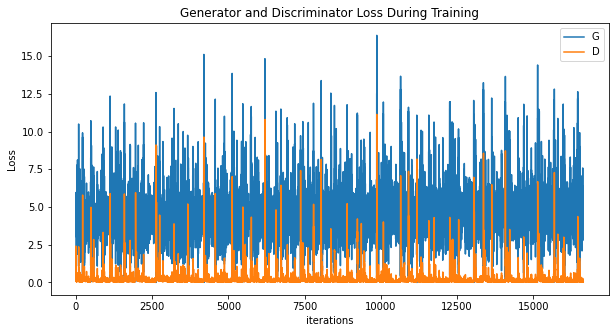

In [9]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

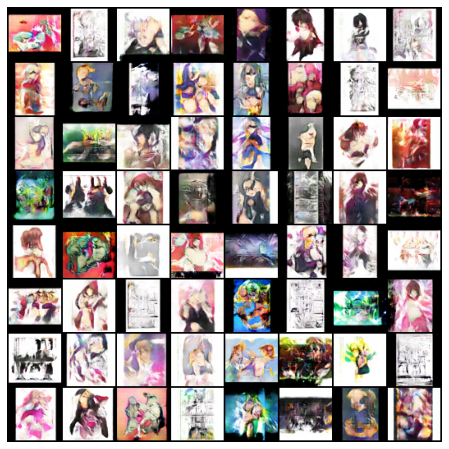

In [10]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

# Real vs Fakes

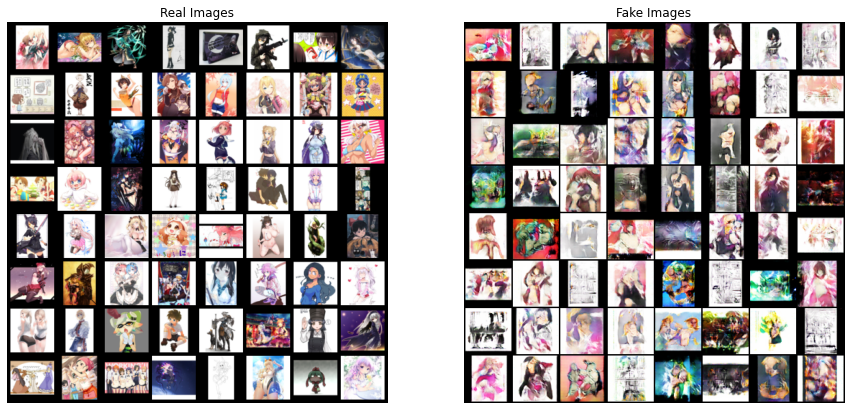

In [11]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()